# EarthCam Construction Site Intelligence Project

**Role:** Junior Data Scientist Candidate
**Goal:** Build an end-to-end computer vision pipeline to categorize site activity into 'Safety', 'Productivity', and 'Security' pillars.

---

## Phase 1: Environment Setup & Data Preparation

In [ ]:
# Install the Ultralytics package (YOLOv8)
!pip install ultralytics

import cv2
import pandas as pd
import sqlite3
import os
from ultralytics import YOLO
from datetime import datetime
import matplotlib.pyplot as plt
from IPython.display import Image, display

print("Setup complete. Libraries loaded.")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 19.5 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Setup complete. Libraries loaded.


In [4]:
# Define the Business Pillars for aggregating detection data
# This dictionary maps the granular classes to executive-level categories.
CLASS_MAPPING = {
    # Safety Pillar (PPE Compliance)
    'Hardhat': 'Safety',
    'Mask': 'Safety',
    'NO-Hardhat': 'Safety',
    'NO-Mask': 'Safety',
    'NO-Safety Vest': 'Safety',
    'Person': 'Safety',
    'Safety Cone': 'Safety',
    'Safety Vest': 'Safety',

    # Productivity Pillar (Heavy Machinery & Active Work)
    'Excavator': 'Productivity',
    'Dump Truck': 'Productivity',
    'concrete mixer truck': 'Productivity',
    'grader': 'Productivity',
    'loader': 'Productivity',
    'truck': 'Productivity',
    'wheel loader': 'Productivity',

    # Security & Logistics (Site Access & Assets)
    'Bus': 'Security/Logistics',
    'Minivan': 'Security/Logistics',
    'SUV': 'Security/Logistics',
    'Sedan': 'Security/Logistics',
    'Trailer': 'Security/Logistics',
    'Van': 'Security/Logistics',
    'Vehicle': 'Security/Logistics',
    'machinery': 'Security/Logistics',

    # catch-all
    'fire hydrant': 'Security/Logistics'
}

# Helper function to get pillar from class name
def get_business_pillar(class_name):
    return CLASS_MAPPING.get(class_name, 'Uncategorized')

print("Business Pillars and Mapping Logic defined.")

Business Pillars and Mapping Logic defined.


## Phase 2: Model Training (YOLOv8-Nano)

In [16]:
model = YOLO('yolov8n.pt')

data_yaml_path = '/content/drive/MyDrive/Construction Site Safety.v1i.yolov8/data.yaml'
print(f"Training from Drive: {data_yaml_path}")

results = model.train(
    data=data_yaml_path,
    epochs=50,
    imgsz=640,
    project='/content/drive/MyDrive/earthcam-runs',  # Save here
    name='v1',
    plots=True
)
print("✅ Training done—check Drive!")

Training from Drive: /content/drive/MyDrive/Construction Site Safety.v1i.yolov8/data.yaml
Ultralytics 8.4.9 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/Construction Site Safety.v1i.yolov8/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_sca

In [32]:
import yaml
data_yaml_path = '/content/drive/MyDrive/Construction Site Safety.v1i.yolov8/data.yaml'

with open(data_yaml_path, 'r') as f:
    data = yaml.safe_load(f)

print("=== EarthCam Dataset Info ===")
print(f"Train path: {data['train']}")
print(f"Val path: {data['val']}")
print(f"Test path: {data.get('test', 'None')}")
print(f"Num classes: {data['nc']}")

print("\nClasses (25 total):")
classes = data['names'] if isinstance(data['names'], list) else list(data['names'].values())
for i, cls in enumerate(classes):
    print(f"  {i}: '{cls}'")

# All splits
base_dir = os.path.dirname(data_yaml_path)
train_imgs = len([f for f in os.listdir(f"{base_dir}/train/images") if f.endswith(('.jpg', '.png'))])
val_imgs = len([f for f in os.listdir(f"{base_dir}/valid/images") if f.endswith(('.jpg', '.png'))])
test_imgs = len([f for f in os.listdir(f"{base_dir}/test/images") if f.endswith(('.jpg', '.png'))]) if os.path.exists(f"{base_dir}/test/images") else 0

print(f"\nImages: train={train_imgs}, val={val_imgs}, test={test_imgs}")

print("\n✅ Ready!")


=== EarthCam Dataset Info ===
Train path: ../train/images
Val path: ../valid/images
Test path: ../test/images
Num classes: 25

Classes (25 total):
  0: 'Excavator'
  1: 'Gloves'
  2: 'Hardhat'
  3: 'Ladder'
  4: 'Mask'
  5: 'NO-Hardhat'
  6: 'NO-Mask'
  7: 'NO-Safety Vest'
  8: 'Person'
  9: 'SUV'
  10: 'Safety Cone'
  11: 'Safety Vest'
  12: 'bus'
  13: 'dump truck'
  14: 'fire hydrant'
  15: 'machinery'
  16: 'mini-van'
  17: 'sedan'
  18: 'semi'
  19: 'trailer'
  20: 'truck'
  21: 'truck and trailer'
  22: 'van'
  23: 'vehicle'
  24: 'wheel loader'

Images: train=521, val=114, test=82

✅ Ready!


Model Performance - Confusion Matrix:


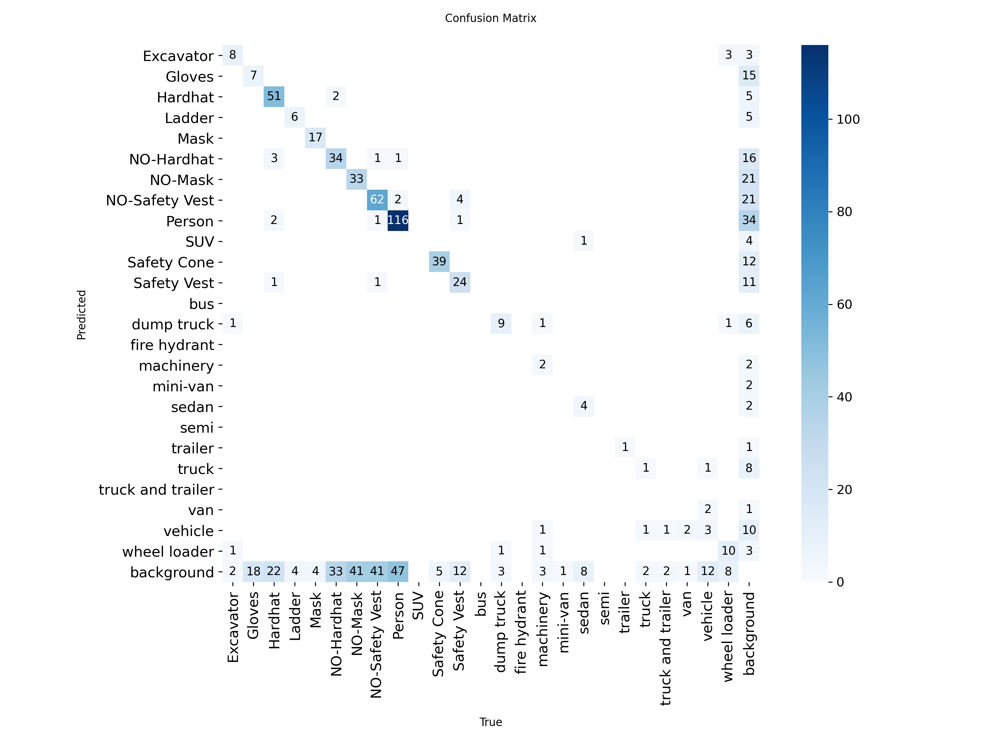


Training Metrics:


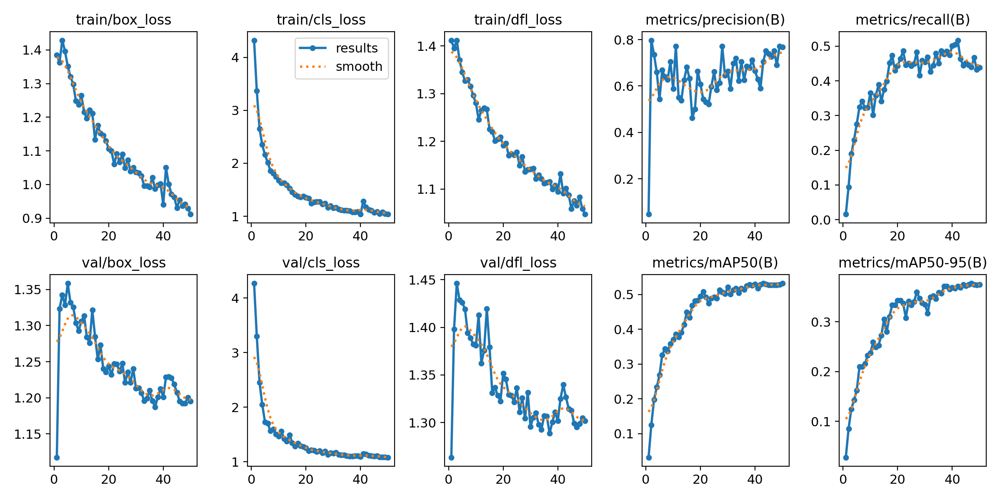

In [22]:
# Drive paths (matches your project arg)
confusion_matrix_path = '/content/drive/MyDrive/earthcam-runs/v1/confusion_matrix.png'
results_path = '/content/drive/MyDrive/earthcam-runs/v1/results.png'

try:
    print("Model Performance - Confusion Matrix:")
    display(Image(filename=confusion_matrix_path))

    print("\nTraining Metrics:")
    display(Image(filename=results_path))
except Exception as e:
    print(f"Plots generating... Check Drive: {e}")
    !ls -la /content/drive/MyDrive/earthcam-runs/v1/


## Phase 3: Inference Engine & Analytics Generation

In [23]:
# === PHASE 3: INFERENCE ENGINE & ANALYTICS (DRIVE EDITION) ===

# 1. SETUP PATHS
# Upload a video to Drive and update name here!
video_path = '//YTDowncom_YouTube_SiteCloud-AERIAL-Drone-Photography-and-V_Media_IVspDj02u8U_001_1080p.mp4'

# Your 50-epoch model (saved in Drive from Phase 2)
best_weights = '/content/drive/MyDrive/earthcam-runs/v1/weights/best.pt'

# 2. LOAD MODEL
if not os.path.exists(best_weights):
    print(f"⚠️ Warning: Weights not found at {best_weights}")
    print("Using standard yolov8n.pt (demo mode). Check your Drive path!")
    best_model = YOLO('yolov8n.pt')
else:
    print(f"✅ Loading custom EarthCam model: {best_weights}")
    best_model = YOLO(best_weights)

# 3. RUN INFERENCE
print(f"Processing video: {video_path}...")
analytics_data = []

# stream=True is efficient for long videos
# save=True saves the annotated video to 'runs/detect/predict'
results = best_model.predict(source=video_path, stream=True, save=True, conf=0.4)

frame_count = 0

# 4. PROCESS FRAMES
for frame in results:
    frame_count += 1

    # Get detected class IDs and Names
    class_indices = frame.boxes.cls.tolist()
    class_names = [best_model.names[int(idx)] for idx in class_indices]

    # Initialize counters for this frame
    frame_metrics = {
        'Safety': 0,
        'Productivity': 0,
        'Security/Logistics': 0,
        'Uncategorized': 0
    }

    # Map detections to Business Pillars (Safety, Productivity, etc.)
    # Assumes get_business_pillar() is defined from Phase 1
    for name in class_names:
        pillar = get_business_pillar(name)
        frame_metrics[pillar] += 1

    # Create structured record
    record = {
        'frame_id': frame_count,
        # Simulate time passing (30 FPS assumption for timestamp)
        'timestamp': datetime.now().strftime("%Y-%m-%d %H:%M:%S"),
        'total_detections': len(class_names),
        **frame_metrics
    }
    analytics_data.append(record)

    if frame_count % 50 == 0:
        print(f"Processed frame {frame_count}...")

print(f"✅ Video processing complete. Processed {frame_count} frames.")

# 5. CREATE DATAFRAME
df = pd.DataFrame(analytics_data)
print("\n=== Analytics Preview ===")
print(df.head())

# Save inferred video to Drive for easy viewing
# YOLO saves to runs/detect/predict/, let's copy it to Drive
import shutil
source_video_dir = 'runs/detect/predict'
if os.path.exists(source_video_dir):
    dest_dir = '/content/drive/MyDrive/earthcam-inference'
    shutil.copytree(source_video_dir, dest_dir, dirs_exist_ok=True)
    print(f"🎥 Annotated video saved to Drive folder: {dest_dir}")


✅ Loading custom EarthCam model: /content/drive/MyDrive/earthcam-runs/v1/weights/best.pt
Processing video: //YTDowncom_YouTube_SiteCloud-AERIAL-Drone-Photography-and-V_Media_IVspDj02u8U_001_1080p.mp4...

video 1/1 (frame 1/931) //YTDowncom_YouTube_SiteCloud-AERIAL-Drone-Photography-and-V_Media_IVspDj02u8U_001_1080p.mp4: 384x640 2 Excavators, 2 Persons, 1 vehicle, 41.4ms
video 1/1 (frame 2/931) //YTDowncom_YouTube_SiteCloud-AERIAL-Drone-Photography-and-V_Media_IVspDj02u8U_001_1080p.mp4: 384x640 2 Excavators, 2 Persons, 1 vehicle, 9.3ms
video 1/1 (frame 3/931) //YTDowncom_YouTube_SiteCloud-AERIAL-Drone-Photography-and-V_Media_IVspDj02u8U_001_1080p.mp4: 384x640 2 Excavators, 2 Persons, 1 Safety Cone, 2 vehicles, 9.6ms
video 1/1 (frame 4/931) //YTDowncom_YouTube_SiteCloud-AERIAL-Drone-Photography-and-V_Media_IVspDj02u8U_001_1080p.mp4: 384x640 2 Excavators, 3 Persons, 1 Safety Vest, 1 dump truck, 2 vehicles, 9.5ms
video 1/1 (frame 5/931) //YTDowncom_YouTube_SiteCloud-AERIAL-Drone-Photograph

In [33]:
df = pd.DataFrame(analytics_data)
print(df.head())

   frame_id            timestamp  total_detections  Safety  Productivity  \
0         1  2026-02-01 05:13:22                 5       2             2   
1         2  2026-02-01 05:13:22                 5       2             2   
2         3  2026-02-01 05:13:22                 7       3             2   
3         4  2026-02-01 05:13:22                 9       4             2   
4         5  2026-02-01 05:13:22                 9       3             2   

   Security/Logistics  Uncategorized  
0                   0              1  
1                   0              1  
2                   0              2  
3                   0              3  
4                   0              4  


In [28]:
import glob
from IPython.display import Video

# 1. Glob finds the latest AVI (no copy-paste needed)
latest_avi = glob.glob('/content/drive/MyDrive/earthcam-inference/*.avi')[0]

# 2. Convert & Play
!ffmpeg -i "$latest_avi" -vcodec libx264 "play_me.mp4" -y -loglevel quiet
Video("play_me.mp4", embed=True)


## Phase 4: SQL Pipeline & Export

In [34]:
# 1. CSV
csv_filename = 'final_site_report.csv'
df.to_csv(csv_filename, index=False)
print(f"CSV exported: {csv_filename}")

# 2. SQL Pipeline
db_name = 'earthcam_analytics.db'
conn = sqlite3.connect(db_name)
cursor = conn.cursor()

# Create table
cursor.execute('''
CREATE TABLE IF NOT EXISTS site_logs (
    id INTEGER PRIMARY KEY AUTOINCREMENT,
    frame_id INTEGER,
    timestamp TEXT,
    total_detections INTEGER,
    safety_count INTEGER,
    productivity_count INTEGER,
    security_count INTEGER
);
''')

# Insert Data
for _, row in df.iterrows():
    cursor.execute('''
        INSERT INTO site_logs (frame_id, timestamp, total_detections, safety_count, productivity_count, security_count)
        VALUES (?, ?, ?, ?, ?, ?)
    ''', (
        row['frame_id'],
        row['timestamp'],
        row['total_detections'],
        row['Safety'],
        row['Productivity'],
        row['Security/Logistics']
    ))

conn.commit()
conn.close()

print(f"Database populated: {db_name}")

CSV exported: final_site_report.csv
Database populated: earthcam_analytics.db
